**Part 1: Data Cleaning, EDA and Feature Engineering**  

1. Train Data Cleaning, EDA and Feature Engineering
2. Weather Data Cleaning, EDA and Feature Engineering
3. Spray Data Cleaning, EDA and Feature Engineering
4. **Combined EDA and Feature Engineering, Pre-Processing**  

Part 2: Modeling  

  5. Modelling, Iteration, Limitations, CBA, Recommendations & Conclusion

## Table of Contents
1. [Problem Statement](#1.-Problem-Statement)  
2. [Module Imports](#2.-Module-Imports)   
3. [Function Definitions](#3.-Function-Definitions)  
4. [Read CSVs](#4.-Read-CSVs)
5. [EDA](#5.-EDA)
6. [Feature Engineering](#6.-Feature-Engineering)
7. [Exporting to csv](#7.-Exporting-to-csv)

## 1. Problem Statement
[Return to top](#Table-of-Contents)

- Introduction  
West Nile virus is most commonly spread to humans through infected mosquitos. Around 20% of people who become infected with the virus develop symptoms ranging from a persistent fever, to serious neurological illnesses that can result in death.
In 2002, the first human cases of West Nile virus were reported in Chicago. By 2004 the City of Chicago and the Chicago Department of Public Health (CDPH) had established a comprehensive surveillance and control program that is still in effect today. Every week from late spring through the fall, mosquitos in traps across the city are tested for the virus. The results of these tests influence when and where the city will spray airborne pesticides to control adult mosquito populations.  


- Problem Statement  
Given weather, location, testing, and spraying data, this competition asks you to predict when and where different species of mosquitos will test positive for West Nile virus. A more accurate method of predicting outbreaks of West Nile virus in mosquitos will help the City of Chicago and CPHD more efficiently and effectively allocate resources towards preventing transmission of this potentially deadly virus.  


- Stakeholders:
    - Primary stakeholders: City of Chicago and the Chicago Department of Public Health (CDPH)  
    - Secondary stakeholders: General public for awareness

## 2. Module Imports
[Return to top](#Table-of-Contents)

In [1]:
# Standard imports
import numpy as np # Version 1.20.1
import pandas as pd # Version 1.2.4
# Pandas settings
pd.set_option('display.max_rows', None)
pd.set_option("display.max_columns", None)

# Time Series imports
import datetime as dt # Version 2.8.1

# Plotting imports
import folium # 0.12.1.post1
from branca.element import Figure # 0.4.2
import seaborn as sns # Version 0.11.1
import matplotlib.pyplot as plt # Version 3.3.4
# Please reduce "DPI" values below if plots take too long to display 
# Higher values make plots remain clear when zoomed in
plt.rcParams['figure.dpi'] = 200
plt.style.use('ggplot')

# Geographical imports
import haversine as hs # Version 2.5.1
from haversine import Unit

# Warnings
import warnings
warnings.simplefilter(action='ignore')

## 3. Function Definitions
[Return to top](#Table-of-Contents)

In [2]:
# Correlation plotter with mask
def corr_plotter_wmask(df,columns):
    corr = df[columns].corr(method = 'pearson')
    np.tril(np.ones(corr.shape)).astype('bool')[0:5,0:5]
    # Creating mask for upper triangle
    df_lt = corr.where(np.tril(np.ones(corr.shape)).astype('bool')) 
    # Applying mask for upper triangle
    hmap=sns.heatmap(df_lt,vmin=-1,vmax=1,cmap='coolwarm', annot = True ) 
    # using masked corr.df to plot 'half' heatmap
    hmap.set_xticklabels(hmap.get_xticklabels(), rotation=45, horizontalalignment='right');

In [3]:
# Time lag column creator
def timelag_col_creator(df, columns, timelag_range):
    for col in columns:
        for num in range(1,timelag_range+1):
            df[col+'_lag'+str(num)] = df[col].shift(num)

# Roll mean column creator
def rollmean_col_creator(df, columns, window):
    for col in columns:
        df[col+'_rm'+str(window)] = df[col].rolling(window).mean()

## 4. Read CSVs
[Return to top](#Table-of-Contents)

In [4]:
spray_cleaned = pd.read_csv('../data/spray_cleaned.csv')
train_cleaned = pd.read_csv('../data/train_cleaned.csv', parse_dates = ['Date'])
weather_cleaned = pd.read_csv('../data/weather_clean.csv', parse_dates = ['Date'])
test = pd.read_csv('../data/test.csv', parse_dates = ['Date'])

In [5]:
# Saving pos/neg WnvPresent traps as separatet dfs
train_pos_only = train_cleaned[train_cleaned['WnvPresent'] == 1]
train_neg_only = train_cleaned[train_cleaned['WnvPresent'] == 0]

## 5. EDA
[Return to top](#Table-of-Contents)

**Visualizing positive trap and spray locations for years 2011, 2013**

In [6]:
chicago = [41.881832, -87.623177] # Chicago Coord
trap2011overlap = [41.973845,-87.805059]
trap2013overlap = {'T233': (42.009876,-87.807277),
                   'T008': (42.008314,-87.777921),
                   'T013': (41.923738,-87.785288),
                   'T151': (41.916265,-87.800515),
                   'T230': (41.904194,-87.756155),
                   'T028': (41.986921,-87.689778),
                   'T231': (41.98728,-87.666066),
                   'T228': (41.951866,-87.725057),
                   'T147': (41.932094,-87.700117),
                   'T066': (41.77166,-87.703047),
                   'T159': (41.732984,-87.649642),
                   'T089': (41.723195,-87.64997),
                   'T227': (41.728495,-87.600963),
                   'T080': (41.754676,-87.612922)
                  }
# Plotting Trap locations for each of the years
map_obj = folium.Map(location = chicago, width = '100%', height = '100%', zoom_start = 9, tiles= 'CartoDB dark_matter')

# Adding Layers into the map object for Negative trap visualizations
for year, group in train_neg_only.groupby('Year'):
        feature_group = folium.FeatureGroup(str(year)+' Negative Traps')
        for row in group.itertuples():
            folium.CircleMarker(location = [row.Latitude, row.Longitude], radius = 1, color = 'lightgreen',tooltip =str(row.Trap)).add_to(feature_group)
        feature_group.add_to(map_obj)

# Adding Layers into the map object for positive trap visualizations
for year, group in train_pos_only.groupby('Year'):
        feature_group = folium.FeatureGroup(str(year)+' Positive Traps')
        for row in group.itertuples():
            folium.CircleMarker(location = [row.Latitude, row.Longitude], radius = 1, color = 'red',tooltip =str(row.Trap)).add_to(feature_group)
# A circle of 1.3km radius is plotted with positive traps, as an indication of potential flight range of WNV+ mosquitoes
            folium.Circle(location = [row.Latitude, row.Longitude], radius = 1300, tooltip = str(row.Trap)+' Eff. Rad. (1.3km)').add_to(feature_group)
        feature_group.add_to(map_obj)
        
# Adding Layers into the map object for spray visualizations
for year, group in spray_cleaned.groupby('Year'):
    feature_group = folium.FeatureGroup(str(year)+' Sprays')
    for row in group.itertuples():
        if row.Year == 2011:
            folium.CircleMarker(location = [row.Latitude, row.Longitude], radius = 1, color = 'yellow',tooltip =str(row.Date)).add_to(feature_group)
        else:
            folium.CircleMarker(location = [row.Latitude, row.Longitude], radius = 1, color = 'yellow',tooltip =str(row.Date)).add_to(feature_group)          
    feature_group.add_to(map_obj)

folium.LayerControl().add_to(map_obj)
map_obj


# Refer to top right corner of Map visualizations for toggling of layers

**Observations for traps YOY**

**20XX**:*Map layer controls checked** : `20XX Positive Traps | 20XX Negative Traps` 
- Trap numbers fluctuate YOY, positions of traps also shift across years  
This results in fluctuating measurements of mosquito populations across years, which makes it more problematic when trying to identify areas which are prone of WNV+ (if location is standardized across years, we can identify areas/clusters through tracking prior WNV positive counts in previous years).

**Observations for Coinciding Traps and Sprays**  
**2011**: *Map layer controls checked** : `2011 Positive Traps | 2011 Sprays`  
- Based on the visualization, we see only one trap location(`T223`) have coincided with the spraying efforts. As the spraying was conducted on 07-09-2011, lets take a look at the trap information prior to spraying date. 

In [7]:
# Coinciding traps laid in 2011, coupled with NumMosquitos and WnvPresent
train_pos_only[(train_pos_only['Trap'] == 'T223') & (train_pos_only['Year'] == 2011)][['Trap','Date','NumMosquitos','WnvPresent']]
# Click ... below to see output

,Trap,Date,NumMosquitos,WnvPresent
5582,T223,2011-07-29,50,1
5825,T223,2011-08-12,3,1
6042,T223,2011-08-26,5,1
6114,T223,2011-09-01,11,1
6477,T223,2011-09-23,24,1


- According to this [`source`](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3278816/), we know that the average flight distance of mosquitoes is about 1.3km. We see some spillover of the 1.3km radius in the north and western direction, while the southern half of the radius was not covered by sprays.

**2013**: *Map layer controls checked** : `2013 Positive Traps | 2013 Sprays`
- 2013 was a year where there were significantly more coinciding sprays with traps with coverage within the 1.3km radius of their coinciding traps. There were two areas (Garfield Park, Greater Grand Crossing) where the decision made for spraying may not have been caused by the observations made through the traps.  
  
  
- Garfield Park
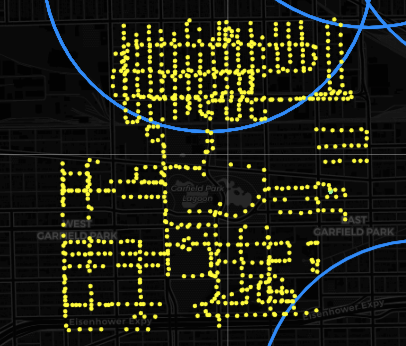
Based on the area where spraying has covered, there should have been a trap which was flagged positive inside Garfield Park Lagoon, however there was no trap at all, suggesting that spraying efforts may not be solely influenced by looking at the positivity of surveilance traps.


- Greater Grand Crossing
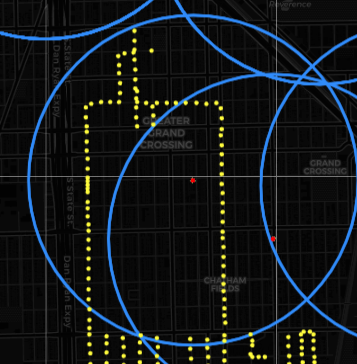
The general area of Greater Grand Crossing has multiple overlapping traps flagged as WNV+, however spraying efforts have been minimal in the surrounding area. Additionally, it seems puzzling as to why the spray was only done in what seems like a perimeter basis around the South of Greater Grand Crossing.

In [8]:
# Coinciding Traps laid in 2013, coupled with NumMosquitos and WnvPresent
train_pos_only2013 = train_pos_only[train_pos_only['Year'] == 2013]
train_pos_only2013.groupby(by = ['Trap','Date'])[['NumMosquitos','WnvPresent']].sum()
# Click ... below to see output

NumMosquitos  WnvPresent
Trap  Date                                
T002  2013-08-08           133           2
      2013-08-22            46           2
      2013-08-29            35           1
      2013-09-12            32           1
T003  2013-07-19             7           1
      2013-08-01            35           1
      2013-08-08            28           1
      2013-08-22            23           1
      2013-08-29            30           1
      2013-09-06            35           1
      2013-09-26             3           1
T008  2013-07-12            78           2
      2013-07-19            50           1
      2013-08-29            41           1
T009  2013-08-08            38           1
      2013-08-29            96           2
      2013-09-06            30           1
T011  2013-08-08            17           1
      2013-09-12             9           1
      2013-09-19            10           1
T012  2013-08-22             5           1
      2013-09-19            11           1
T013  2013-07-19            23           1
      2013-08-01            42           1
      2013-08-08            81           2
      2013-08-15            40           1
      2013-09-06            36           1
      2013-09-12            21           1
      2013-09-19            26           1
T027  2013-08-08            16           1
      2013-08-22            37           2
      2013-09-06            19           1
      2013-09-12            24           2
T028  2013-08-15            71           2
      2013-08-22            14           2
      2013-08-29            17           1
      2013-09-12            45           1
T030  2013-07-19            50           1
      2013-08-01            46           1
      2013-08-08            50           1
      2013-08-15            54           1
      2013-08-22            47           1
      2013-09-06            45           1
      2013-09-19            21           1
T031  2013-07-19            16           1
      2013-08-29            24           2
T033  2013-08-22            16           1
      2013-08-29            15           1
      2013-09-06            32           1
T035  2013-09-06            31           1
      2013-09-26             6           1
T039  2013-08-29            19           1
      2013-09-12            14           1
T047  2013-08-15            51           2
      2013-08-22            13           1
T048  2013-07-19            37           1
      2013-08-22            31           1
T054  2013-07-25             3           1
      2013-09-06           120           2
      2013-09-12            42           1
      2013-09-19            12           1
T054C 2013-08-15            45           1
T061  2013-08-08            48           1
      2013-08-15            33           1
      2013-08-22             1           1
      2013-09-06            13           1
T063  2013-08-22             6           1
T065  2013-08-08            12           2
T066  2013-08-08            46           1
      2013-08-15            31           1
      2013-08-22            18           2
      2013-09-12            39           1
T069  2013-09-06            17           1
T073  2013-07-12             9           1
T077  2013-09-06             1           1
T079  2013-07-25            18           1
T080  2013-08-08            24           1
T082  2013-08-08             2           1
      2013-08-22            15           1
T089  2013-08-08             4           1
      2013-08-29             5           1
      2013-09-19             6           1
T090  2013-08-29            12           1
      2013-09-12            21           1
      2013-09-19             6           1
T094  2013-06-28            38           1
      2013-08-01             4           1
      2013-08-15             8           1
T095  2013-08-29            28           1
T102  2013-09-12             5           1
T114  2013-08-29            13           1
      2013-09-06   

We decided to merge any information from the spray dataset, as the data in it (Date, Latitude, Longitude values of sprays) does not aid in prediction and would just serve as noise. Moreover, it is very likely that the location's of sprays ought to be influenced by data from the traps. As for the weather data, it was observed that data came as two sets from each station (1,2) for a given date, as there were some data that was not recorded from station 2, we will pick station 1's data for merging as it is more objectively 'complete'.

In [9]:
train_clean_compare = train_cleaned.merge(weather_cleaned[weather_cleaned['Station']==1], on='Date')

As we have features which are belonging to similar groups identified in the Weather notebook, we should check their correlation against our target variable `WNVPresent` to inform us on which one to keep.

In [10]:
temperature_cols = ['Tmax', 'Tmin', 'Tavg', 'Heat', 'Cool','WnvPresent']
humidity_cols = ['DewPoint','WetBulb','WnvPresent']
sun_cols = ['Sunrise','Sunset','Daylight_Hours','WnvPresent']
misc_cols = ['StnPressure','SeaLevel','AvgSpeed','ResultSpeed','WnvPresent']

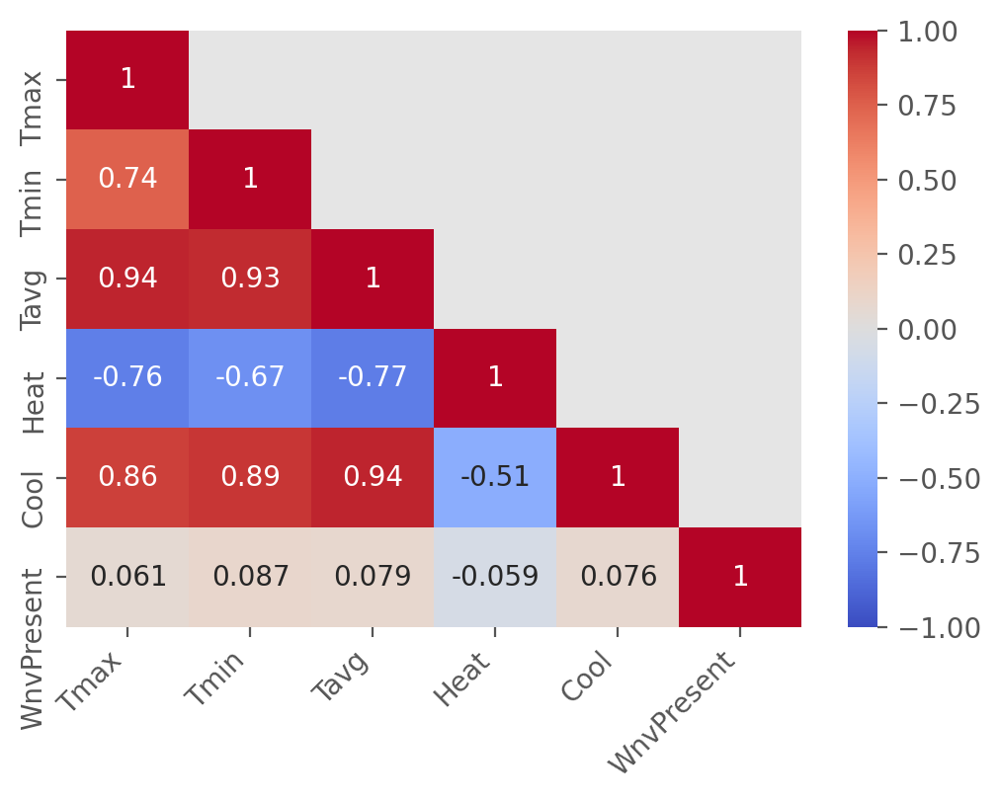

In [11]:
# Plotting temperature variables against WnvPresent in a correlation heatmap 
corr_plotter_wmask(train_clean_compare,temperature_cols)

We will keep use Tmin from the temperature group.

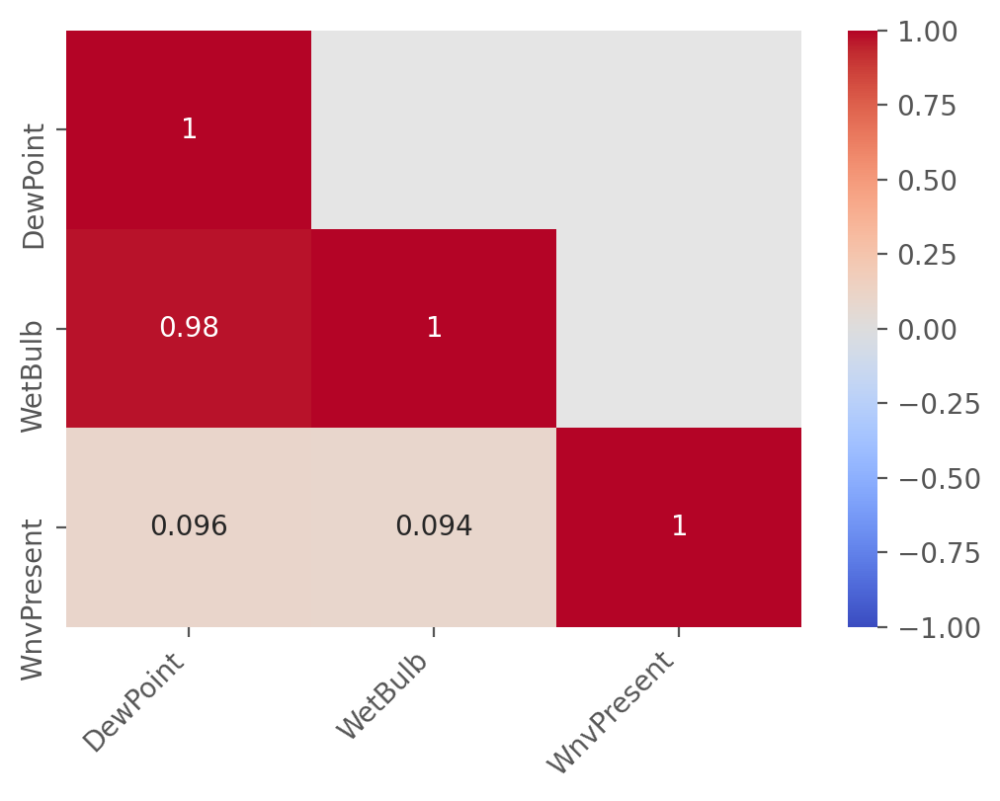

In [12]:
# Plotting humidity variables against WnvPresent in a correlation heatmap 
corr_plotter_wmask(train_clean_compare,humidity_cols)

We will keep DewPoint from the humidity group.

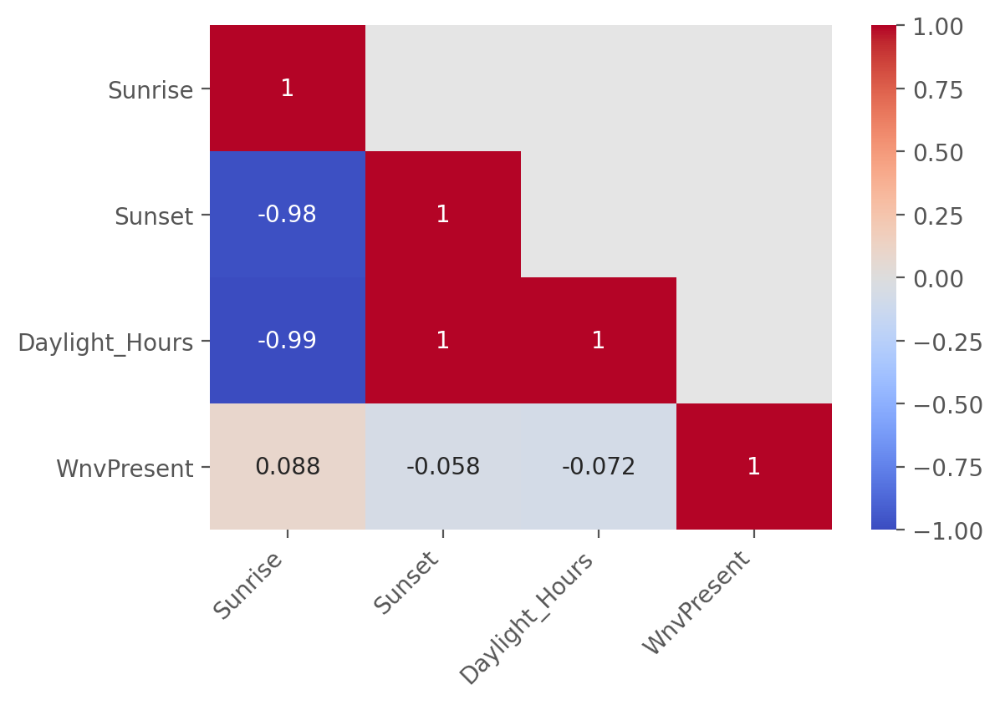

In [13]:
# Plotting sunlight variables against one another in a correlation heatmap 
corr_plotter_wmask(train_clean_compare,sun_cols)

We will keep Sunrise from the sunlight group.

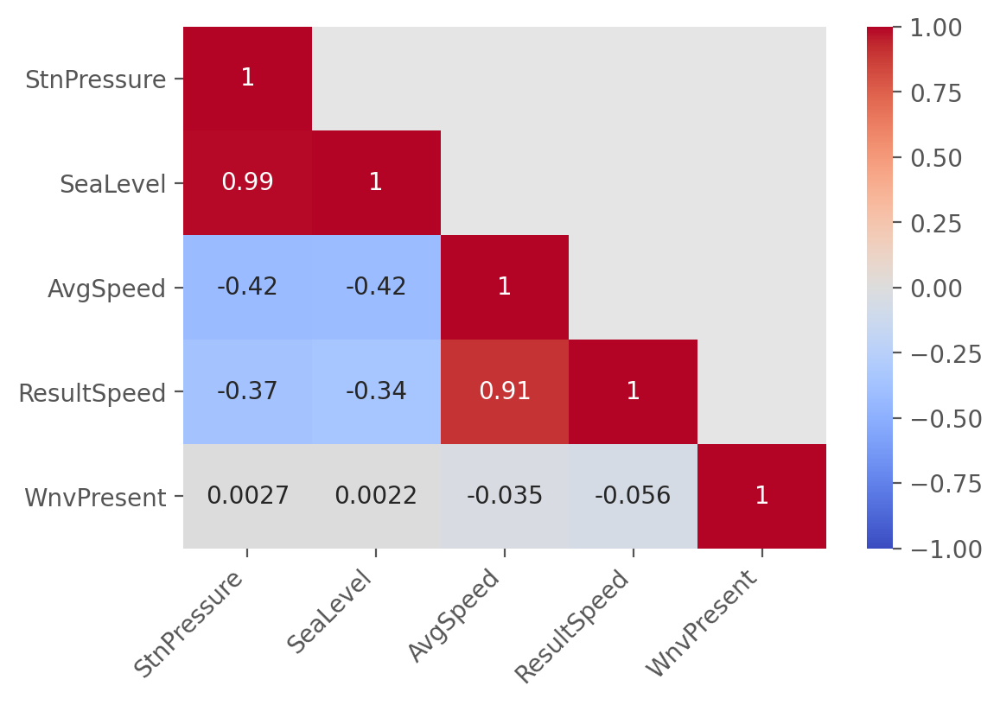

In [14]:
# Plotting pressure,speed against one another in a correlation heatmap 
corr_plotter_wmask(train_clean_compare,misc_cols)

We will keep StnPressure from the pressure group and ResultSpeed from the speed group

Now that we know which are the weather features we want to keep, we will create lagged features for these weather features, as the EDA showed that some of them do exhibit a seasonal relationship.

## 6. Feature Engineering
[Return to top](#Table-of-Contents)

 **Creating time-lagged features using Weather Dataset**

In [15]:
# Identifying cols kept for rollmean and time lagging
cols_to_keep = ['Tmin','DewPoint','Sunrise','PrecipTotal','StnPressure','ResultSpeed','ResultDir']
cols_to_timelag = ['Tmin_rm7','DewPoint_rm7','Sunrise_rm7','PrecipTotal_rm7','StnPressure_rm7','ResultSpeed_rm7','ResultDir_rm7']

In [16]:
# Select only rows from station 1 as weather dataset has two rows for each day
weather = weather_cleaned.loc[weather_cleaned['Station'] == 1]

In [17]:
# create dictionary to store df of weather separated by year
weather_yr = {}
for yr in range(2007, 2015):
    weather_yr["weather{}".format(yr)] = weather.loc[weather_cleaned['Year'] == yr]

As weather data provided does not include every month in a given year (Months 1-12), we face the issue of having rows between years having a big time interval difference, compared to the daily interval between rows for each of the years. We work around this by creating the roll mean (weekly) and time lagged columns from the roll mean(t-1 to t-4) for each of the years rather than on the entire weather dataframe at one go.

In [18]:
# Create roll mean and time lag columns for each individual year, 
for key in weather_yr.keys():
    rollmean_col_creator(weather_yr['{}'.format(key)], cols_to_keep, 7)
    timelag_col_creator(weather_yr['{}'.format(key)], cols_to_timelag, 4)

In [19]:
# drop all nans created from roll mean and time lag
for key in weather_yr.keys():
    weather_yr['{}'.format(key)].dropna(inplace = True)

In [20]:
# Store each key(year) from the weather_yr dict as dfs
weather07= weather_yr['weather2007']
weather08= weather_yr['weather2008']
weather09= weather_yr['weather2009']
weather10= weather_yr['weather2010']
weather11= weather_yr['weather2011']
weather12= weather_yr['weather2012']
weather13= weather_yr['weather2013']
weather14= weather_yr['weather2014']
concat_list = [weather07,weather08,weather09,weather10,weather11,weather12,weather13,weather14]

In [21]:
# Stack dfs of consecutive years together
weather_cleaned_combined = pd.concat(concat_list,axis = 0)
weather_cleaned_combined.reset_index(inplace = True)

In [22]:
# Merge combined weather df with train/test to obtain newly created columns
train_clean_merged = train_cleaned.merge(weather_cleaned_combined[weather_cleaned_combined['Station']==1], on='Date')
test_merged = test.merge(weather_cleaned_combined[weather_cleaned_combined['Station']==1], on='Date')

**Dropping features not used for modelling**

In [23]:
# Dropping identified collinear weather features
train_clean_merged.drop(columns = ['Tmax','Tavg','Heat','Cool'], inplace = True)
train_clean_merged.drop(columns = 'WetBulb', inplace = True)
train_clean_merged.drop(columns = ['Sunset','Daylight_Hours'], inplace = True)
train_clean_merged.drop(columns = ['SeaLevel','AvgSpeed'], inplace = True)

# Drop Trap column as traps are identifiable through Latitude and Longitude values
train_clean_merged.drop(columns = 'Trap', inplace = True)
# Drop the Station there is only one unique value(Station 1)
train_clean_merged.drop(columns = 'Station', inplace = True)
# Drop the old datetime columns which came from source CSVs
train_clean_merged.drop(columns = ['WeekofYear','Month','Year_y','Year_x'], inplace = True)
# Drop the NumMosquitos columns as it is not provided in the test dataset and we are not predicting it
train_clean_merged.drop(columns = 'NumMosquitos', inplace = True)
# Drop roll mean columns as train dataset interval is weekly
train_clean_merged.drop(columns = ['Tmin_rm7','DewPoint_rm7','Sunrise_rm7','PrecipTotal_rm7','StnPressure_rm7','ResultSpeed_rm7','ResultDir_rm7'], inplace = True)
# Drop index column from merge
train_clean_merged.drop(columns = 'index', inplace = True)

# Create new date & time related columns; i.e. year,month and weekofyear
train_clean_merged['Year'] = train_clean_merged['Date'].dt.year
train_clean_merged['Month'] = train_clean_merged['Date'].dt.month
train_clean_merged['WeekofYear'] = train_clean_merged['Date'].dt.isocalendar().week
# Drop date as we no longer need with the new dt columns
train_clean_merged.drop(columns = 'Date', inplace = True)
# Encode Species column to indicate 1 for species that carry WNV and 0 for species that do not 
train_clean_merged['Species'] = train_clean_merged['Species'].apply(lambda x: 1 if x in ['CULEX PIPIENS','CULEX PIPIENS/RESTUANS','CULEX RESTUANS'] else 0)

In [24]:
# Dropping unncessary columns created during import
# train_combined.drop(columns = 'Unnamed: 0', inplace = True)

# Applying same column transformations as what was done on test
test_merged.drop(columns = ['Id','Address','Block','Street','AddressNumberAndStreet','AddressAccuracy'], inplace = True)
# Dropping identified collinear weather features
test_merged.drop(columns = ['Tmax','Tavg','Heat','Cool'], inplace = True)
test_merged.drop(columns = 'WetBulb', inplace = True)
test_merged.drop(columns = ['Sunset','Daylight_Hours'], inplace = True)
test_merged.drop(columns = ['SeaLevel','AvgSpeed'], inplace = True)

# Drop Trap column as traps are identifiable through Latitude and Longitude values
test_merged.drop(columns = 'Trap', inplace = True)
# Drop the Station there is only one unique value(Station 1)
test_merged.drop(columns = 'Station', inplace = True)
# Drop roll mean columns as train dataset interval is weekly
test_merged.drop(columns = ['Tmin_rm7','DewPoint_rm7','Sunrise_rm7','PrecipTotal_rm7','StnPressure_rm7','ResultSpeed_rm7','ResultDir_rm7'], inplace = True)
# Drop index column from merge
test_merged.drop(columns = 'index', inplace = True)

# Create new date & time related columns; i.e. month and weekofyear
test_merged['Month'] = test_merged['Date'].dt.month
test_merged['WeekofYear'] = test_merged['Date'].dt.isocalendar().week
# Drop date as we no longer need with the new dt columns
test_merged.drop(columns = 'Date', inplace = True)
# Encode Species column to indicate 1 for species that carry WNV and 0 for species that do not 
test_merged['Species'] = test_merged['Species'].apply(lambda x: 1 if x in ['CULEX PIPIENS','CULEX PIPIENS/RESTUANS','CULEX RESTUANS'] else 0)

In [25]:
train_clean_merged.columns
# Click ... below to see output

Index(['Species', 'Latitude', 'Longitude', 'WnvPresent', 'Tmin', 'DewPoint',
       'Sunrise', 'Wet_NoWet', 'PrecipTotal', 'StnPressure', 'ResultSpeed',
       'ResultDir', 'Tmin_rm7_lag1', 'Tmin_rm7_lag2', 'Tmin_rm7_lag3',
       'Tmin_rm7_lag4', 'DewPoint_rm7_lag1', 'DewPoint_rm7_lag2',
       'DewPoint_rm7_lag3', 'DewPoint_rm7_lag4', 'Sunrise_rm7_lag1',
       'Sunrise_rm7_lag2', 'Sunrise_rm7_lag3', 'Sunrise_rm7_lag4',
       'PrecipTotal_rm7_lag1', 'PrecipTotal_rm7_lag2', 'PrecipTotal_rm7_lag3',
       'PrecipTotal_rm7_lag4', 'StnPressure_rm7_lag1', 'StnPressure_rm7_lag2',
       'StnPressure_rm7_lag3', 'StnPressure_rm7_lag4', 'ResultSpeed_rm7_lag1',
       'ResultSpeed_rm7_lag2', 'ResultSpeed_rm7_lag3', 'ResultSpeed_rm7_lag4',
       'ResultDir_rm7_lag1', 'ResultDir_rm7_lag2', 'ResultDir_rm7_lag3',
       'ResultDir_rm7_lag4', 'Year', 'Month', 'WeekofYear'],
      dtype='object')

In [26]:
train_clean_merged.shape

(8610, 43)

In [27]:
test_merged.columns
# Click ... below to see output

Index(['Species', 'Latitude', 'Longitude', 'Tmin', 'DewPoint', 'Sunrise',
       'Wet_NoWet', 'PrecipTotal', 'StnPressure', 'ResultSpeed', 'ResultDir',
       'Year', 'Month', 'WeekofYear', 'Tmin_rm7_lag1', 'Tmin_rm7_lag2',
       'Tmin_rm7_lag3', 'Tmin_rm7_lag4', 'DewPoint_rm7_lag1',
       'DewPoint_rm7_lag2', 'DewPoint_rm7_lag3', 'DewPoint_rm7_lag4',
       'Sunrise_rm7_lag1', 'Sunrise_rm7_lag2', 'Sunrise_rm7_lag3',
       'Sunrise_rm7_lag4', 'PrecipTotal_rm7_lag1', 'PrecipTotal_rm7_lag2',
       'PrecipTotal_rm7_lag3', 'PrecipTotal_rm7_lag4', 'StnPressure_rm7_lag1',
       'StnPressure_rm7_lag2', 'StnPressure_rm7_lag3', 'StnPressure_rm7_lag4',
       'ResultSpeed_rm7_lag1', 'ResultSpeed_rm7_lag2', 'ResultSpeed_rm7_lag3',
       'ResultSpeed_rm7_lag4', 'ResultDir_rm7_lag1', 'ResultDir_rm7_lag2',
       'ResultDir_rm7_lag3', 'ResultDir_rm7_lag4'],
      dtype='object')

In [28]:
test_merged.shape

(116293, 42)

## 7. Exporting to csv
[Return to top](#Table-of-Contents)

In [29]:
train_clean_merged.to_csv('../data/train_combined.csv')
weather_cleaned_combined.to_csv('../data/weather_combined.csv')
test_merged.to_csv('../data/test_combined.csv')